## Import

In [1]:
# Import internal modules
import os.path
from typing import List, Set, Dict, TypedDict, Tuple, Optional

# Import 3rd party modules
import pandas as pd
import numpy as np
import librosa
import librosa.display
import IPython.display as ipd
import matplotlib.pyplot as plt
import seaborn as sns

## Create class

In [132]:
class Sound:
    """
    """
    def __init__(self, machine_type: str, model_id: str, noise_db: int, filename: str = "00000000.wav") -> None:
        """
        Function to create an instance of the class.
        """
        self.machine_type: str = machine_type
        self.model_id: str = model_id
        self.noise_db: str = noise_db
        self.filename: str = filename
        self.get_path()

    def __str__(self) -> str:
        """
        Function to print the class instance in the specified format.
        """
        return f"{self.machine_type} - id_{model_id}: {self.noise_db} dB"
    
    def get_path(self) -> None:
        """
        Function to get the relative path of the normal and abnormal sound
        """
        path_list: List[str] = []
        for target in ("normal", "abnormal"):
            path = os.path.join(
                "assets",
                "sounds",
                f"{self.noise_db}_dB_{self.machine_type}",
                f"id_{self.model_id}",
                target,
                self.filename
            )
            path_list.append(path)
        
        self.normal_path: str
        self.abnormal_path: str
        self.normal_path, self.abnormal_path = path_list
    
    def get_amplitude_envelope(self, frame_size, hop_length) -> None:
        """
        Function to compute the amplitude envelope of the normal and abnormal sounds
        """
        self.amplitude_envelope_normal = np.array([max(self.normal_sound[frame_start:(frame_start + frame_size)]) for frame_start in range(0, len(self.normal_sound), hop_length)])
        
        self.amplitude_envelope_abnormal = np.array([max(self.abnormal_sound[frame_start:(frame_start + frame_size)]) for frame_start in range(0, len(self.abnormal_sound), hop_length)])

## Load audio files

In [134]:
# Variables
machine_type_list: List[str] = ["fan", "pump", "slider", "valve"]
model_id: str = "00"
noise_db: int = -6
sound_list: List[str] = []

# Create instances of Sound class
for machine_type in machine_type_list:
    sound_list.append(Sound(machine_type, model_id, noise_db))

In [45]:
# Sound paths
# fan_00_minus6db_normal_path = "assets/sounds/-6_dB_fan/id_00/normal/00000000.wav"
# fan_00_minus6db_abnormal_path = "assets/sounds/-6_dB_fan/id_00/abnormal/00000000.wav"

# pump_00_minus6db_normal_path = "assets/sounds/-6_dB_pump/id_00/normal/00000000.wav"
# pump_00_minus6db_abnormal_path = "assets/sounds/-6_dB_pump/id_00/abnormal/00000000.wav"

# slider_00_minus6db_normal_path = "assets/sounds/-6_dB_slider/id_00/normal/00000000.wav"
# slider_00_minus6db_abnormal_path = "assets/sounds/-6_dB_slider/id_00/abnormal/00000000.wav"

# valve_00_minus6db_normal_path = "assets/sounds/-6_dB_valve/id_00/normal/00000000.wav"
# valve_00_minus6db_abnormal_path = "assets/sounds/-6_dB_valve/id_00/abnormal/00000000.wav"

### Listen audio

In [86]:
# Display normal and abnormal sounds
for sound in sound_list:
    print("************ ", sound," ************")
    print("normal")
    ipd.display(ipd.Audio(sound.normal_path)) # ipd.display() to display multiple Audio objects at once
    print("abnormal")
    ipd.display(ipd.Audio(sound.abnormal_path))

************  fan - id_00: -6 dB  ************
normal


abnormal


************  pump - id_00: -6 dB  ************
normal


abnormal


************  slider - id_00: -6 dB  ************
normal


abnormal


************  valve - id_00: -6 dB  ************
normal


abnormal


### Load audio with librosa

In [136]:
for sound in sound_list:
    sound.normal_sound, sound.normal_sr = librosa.load(sound.normal_path)
    sound.abnormal_sound, sound.abnormal_sr = librosa.load(sound.abnormal_path)

 By default, 
 - the sample rate (= number of samples per second) is 22050 Hz
 - librosa load the sound as a mono (param: mono=True); we can set mono=False, to load the as it is (with the number of channels it has, e.g. stereo which is 2 channels)
 
 
You can specify the duration in seconds: librosa.load(sound.normal_path, duration=10)

In [89]:
# Librosa loaded the sound in an array of samples
sound_list[0].normal_sound

array([-0.01458452, -0.01736989, -0.01558134, ..., -0.03422009,
       -0.04159305, -0.02768844], dtype=float32)

In [99]:
# Sample rate
for sound in sound_list:
    print(f"{sound}: Sample rate of normal sound: {sound.normal_sr}")
    print(f"{sound}: Sample rate of abnormal sound: {sound.abnormal_sr}")

fan - id_00: -6 dB: Sample rate of normal sound: 22050
fan - id_00: -6 dB: Sample rate of abnormal sound: 22050
pump - id_00: -6 dB: Sample rate of normal sound: 22050
pump - id_00: -6 dB: Sample rate of abnormal sound: 22050
slider - id_00: -6 dB: Sample rate of normal sound: 22050
slider - id_00: -6 dB: Sample rate of abnormal sound: 22050
valve - id_00: -6 dB: Sample rate of normal sound: 22050
valve - id_00: -6 dB: Sample rate of abnormal sound: 22050


In [98]:
# Number of samples
# len(fan_00_minus6db_normal_sound)
for sound in sound_list:
    print(f"{sound}: Number of samples of normal sound: {sound.normal_sound.size}")
    print(f"{sound}: Number of samples of abnormal sound: {sound.abnormal_sound.size}")

fan - id_00: -6 dB: Number of samples of normal sound: 220500
fan - id_00: -6 dB: Number of samples of abnormal sound: 220500
pump - id_00: -6 dB: Number of samples of normal sound: 220500
pump - id_00: -6 dB: Number of samples of abnormal sound: 220500
slider - id_00: -6 dB: Number of samples of normal sound: 220500
slider - id_00: -6 dB: Number of samples of abnormal sound: 220500
valve - id_00: -6 dB: Number of samples of normal sound: 220500
valve - id_00: -6 dB: Number of samples of abnormal sound: 220500


Here it is 220500 as the sound duration is 10s:
$$10s * (22050/s) = 220500$$

In [100]:
# Duration of 1 sample
for sound in sound_list:
    sample_duration_normal = 1/sound.normal_sr
    sample_duration_abnormal = 1/sound.abnormal_sr
    print(f"{sound}: Duration of 1 sample of normal sound: {sample_duration_normal:.7f}") # print only 7 decimal digits
    print(f"{sound}: Duration of 1 sample of abnormal sound: {sample_duration_abnormal:.7f}") # print only 7 decimal digits
    

fan - id_00: -6 dB: Duration of 1 sample of normal sound: 0.0000454
fan - id_00: -6 dB: Duration of 1 sample of abnormal sound: 0.0000454
pump - id_00: -6 dB: Duration of 1 sample of normal sound: 0.0000454
pump - id_00: -6 dB: Duration of 1 sample of abnormal sound: 0.0000454
slider - id_00: -6 dB: Duration of 1 sample of normal sound: 0.0000454
slider - id_00: -6 dB: Duration of 1 sample of abnormal sound: 0.0000454
valve - id_00: -6 dB: Duration of 1 sample of normal sound: 0.0000454
valve - id_00: -6 dB: Duration of 1 sample of abnormal sound: 0.0000454


In [101]:
# Duration of sound in seconds
for sound in sound_list:
    duration_normal = sample_duration_normal * sound.normal_sound.size
    duration_abnormal = sample_duration_normal * sound.normal_sound.size
    print(f"Duration of normal sound: {duration_normal:.2f}")
    print(f"Duration of abnormal sound: {duration_abnormal:.2f}")

Duration of normal sound: 10.00
Duration of abnormal sound: 10.00
Duration of normal sound: 10.00
Duration of abnormal sound: 10.00
Duration of normal sound: 10.00
Duration of abnormal sound: 10.00
Duration of normal sound: 10.00
Duration of abnormal sound: 10.00


## Signal visualisation 

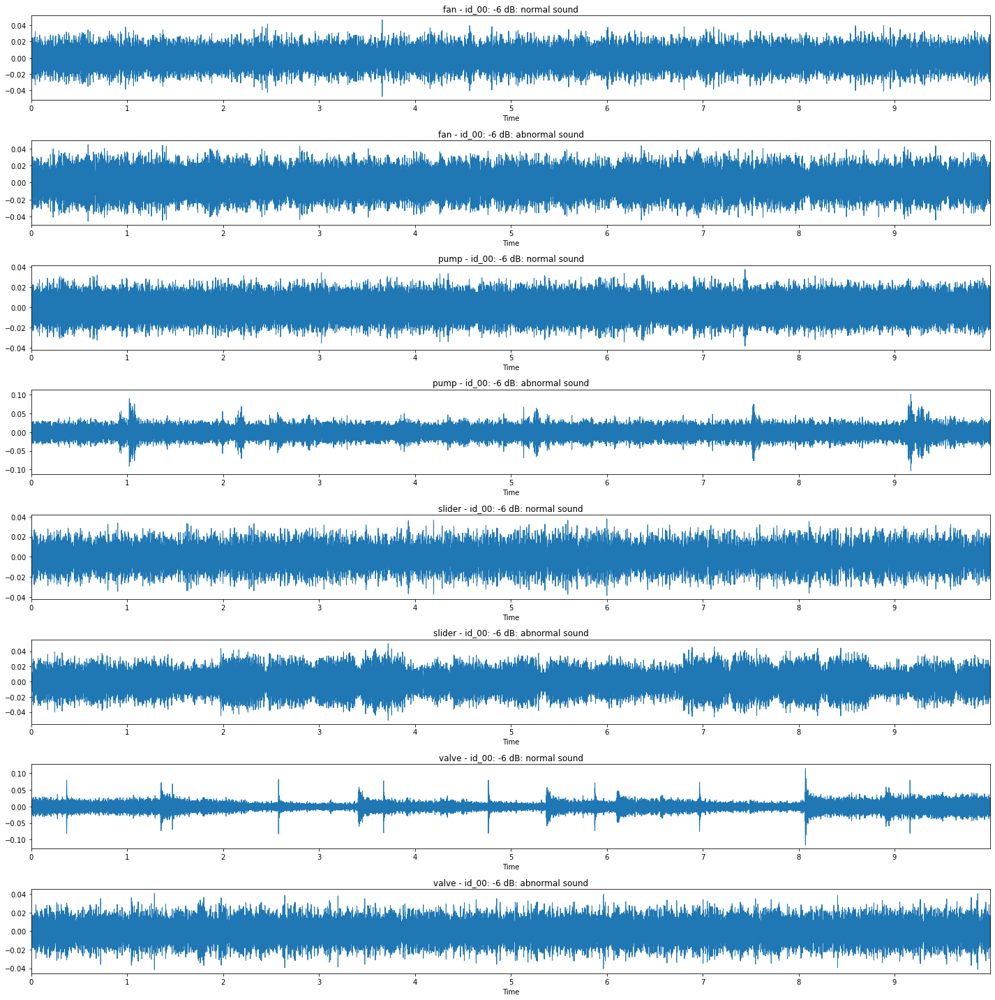

In [105]:
# Visualize the waveforms
fig, axs = plt.subplots(2*len(sound_list),1, figsize=(20, 20))
counter = 0

for sound in sound_list:
    
    librosa.display.waveplot(sound.normal_sound, ax=axs[counter])
    axs[counter].set_title(f"{sound}: normal sound")
    # axs[i].set_ylim([-1, 1])
    counter += 1

    librosa.display.waveplot(sound.abnormal_sound, ax=axs[counter])
    axs[counter].set_title(f"{sound}: abnormal sound")
    # axs[1].set_ylim([-1, 1])
    counter += 1
    
plt.tight_layout()
plt.show()

## Compute amplitude envelope
= max amplitude for each frame (frame size = number of samples we set for each frame)

In [125]:
# CONSTANTS
FRAME_SIZE = 1024
HOP_LENGTH = 512

# def amplitude_envelope(signal, frame_size, hop_length):
#     amplitude_envelope_list: List[float] = []
    
#     # compute AE for each frame
#     for frame_start in range(0, len(signal), hop_length): # 0, 100, 200, ...
#         current_frame_ae: float = max(signal[frame_start:(frame_start + frame_size)])
#         amplitude_envelope_list.append(current_frame_ae)
    
#     return np.array(amplitude_envelope_list)

In [154]:
for sound in sound_list:
    sound.get_amplitude_envelope(FRAME_SIZE,HOP_LENGTH)
    print(f"{sound}: number of normal AE values: {len(sound.amplitude_envelope_normal)}")
    print(f"{sound}: number of abnormal AE values: {len(sound.amplitude_envelope_abnormal)}")

fan - id_00: -6 dB: number of normal AE values: 431
fan - id_00: -6 dB: number of abnormal AE values: 431
pump - id_00: -6 dB: number of normal AE values: 431
pump - id_00: -6 dB: number of abnormal AE values: 431
slider - id_00: -6 dB: number of normal AE values: 431
slider - id_00: -6 dB: number of abnormal AE values: 431
valve - id_00: -6 dB: number of normal AE values: 431
valve - id_00: -6 dB: number of abnormal AE values: 431


In [150]:
pd.DataFrame(zip(sound_list, [sound.amplitude_envelope_normal for sound in sound_list],
                [sound.amplitude_envelope_abnormal for sound in sound_list]),
            columns=["machine", "normal_ae", "abnormal_ae"])

,machine,normal_ae,abnormal_ae
0,fan - id_00: -6 dB,"[0.032630607, 0.032630607, 0.0220081, 0.022008...","[0.026821235, 0.026403636, 0.026403636, 0.0212..."
1,pump - id_00: -6 dB,"[0.022813436, 0.024107125, 0.024107125, 0.0180...","[0.026816584, 0.025206657, 0.02675985, 0.03163..."
2,slider - id_00: -6 dB,"[0.027319489, 0.027319489, 0.023150442, 0.0231...","[0.030459248, 0.026333438, 0.028872337, 0.0288..."
3,valve - id_00: -6 dB,"[0.02903818, 0.02903818, 0.024016907, 0.029707...","[0.028904099, 0.028904099, 0.020223878, 0.0221..."


## Amplitude envelope visualization

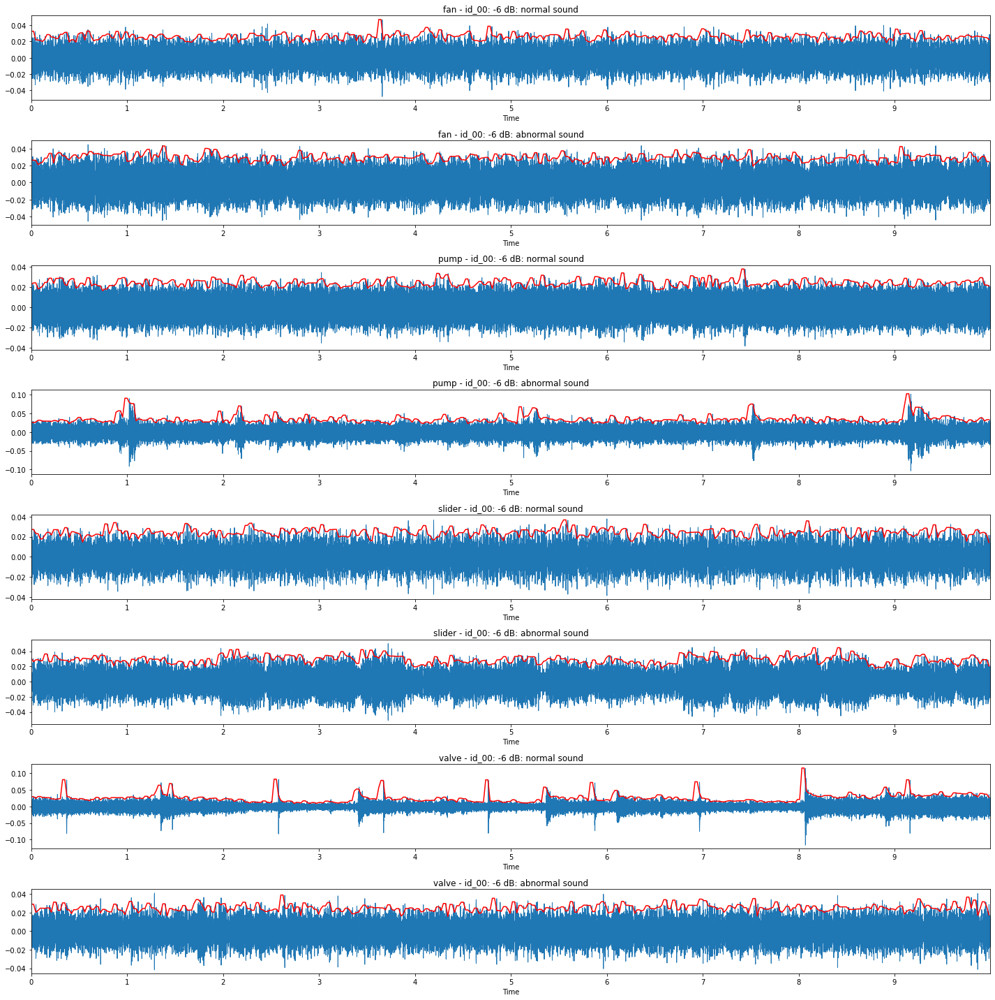

In [153]:
# Visualize the waveforms and the amplitude envelope in red
fig, axs = plt.subplots(2*len(sound_list),1, figsize=(20, 20))
counter = 0
frames = range(0, len(sound_list[0].amplitude_envelope_normal))
time = librosa.frames_to_time(frames, hop_length=HOP_LENGTH)

for sound in sound_list:
    
    librosa.display.waveplot(sound.normal_sound, ax=axs[counter])
    axs[counter].plot(time, sound.amplitude_envelope_normal, color='red')
    axs[counter].set_title(f"{sound}: normal sound")
    # axs[i].set_ylim([-1, 1])
    counter += 1

    librosa.display.waveplot(sound.abnormal_sound, ax=axs[counter])
    axs[counter].plot(time, sound.amplitude_envelope_abnormal, color='red')
    axs[counter].set_title(f"{sound}: abnormal sound")
    # axs[1].set_ylim([-1, 1])
    counter += 1
    
plt.tight_layout()
plt.show()

## Extract Root-Mean Square (RMS)

In [157]:
# CONSTANTS
FRAME_SIZE = 1024
HOP_LENGTH = 512

for sound in sound_list:
    sound.rms_normal = librosa.feature.rms(sound.normal_sound, frame_length=FRAME_SIZE, hop_length=HOP_LENGTH)[0]
    sound.rms_abnormal = librosa.feature.rms(sound.abnormal_sound, frame_length=FRAME_SIZE, hop_length=HOP_LENGTH)[0]

In [160]:
sound_list[0].rms_normal.shape

(431,)

### Visualisation

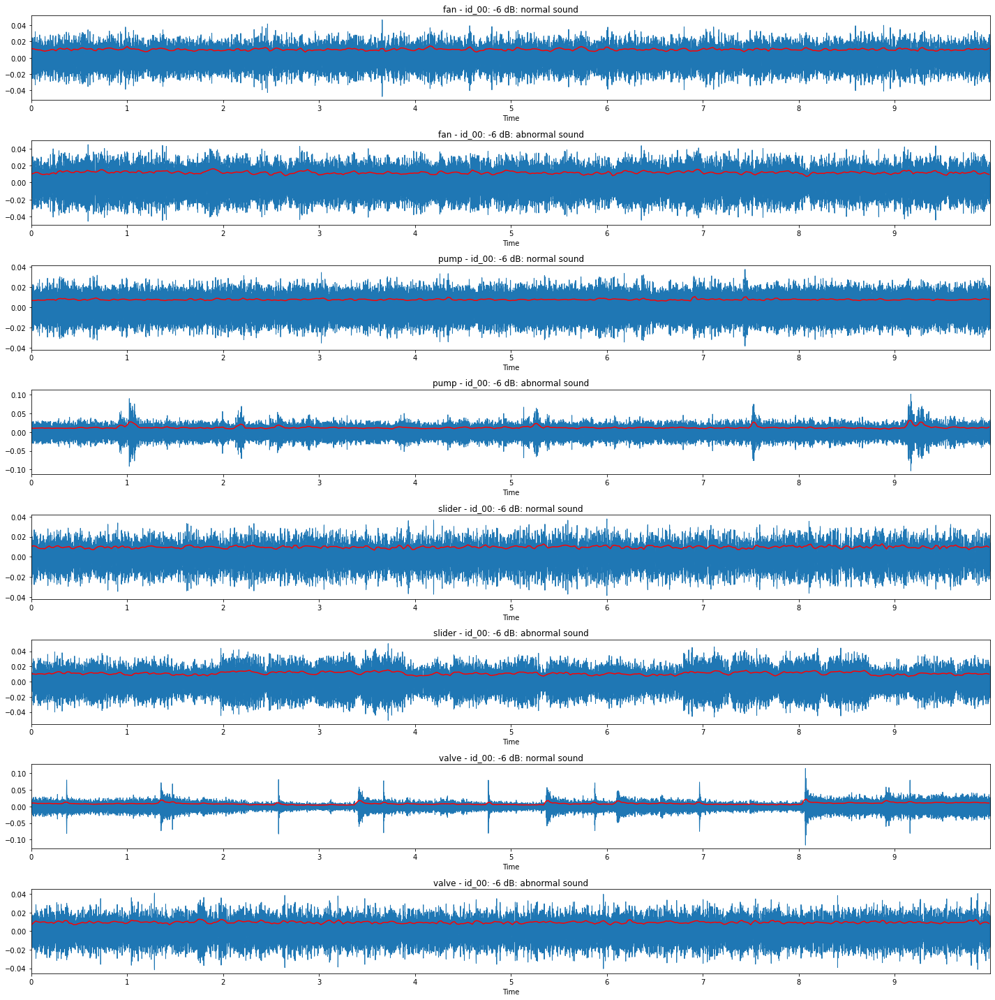

In [161]:
# Visualize the waveforms and rms in red
fig, axs = plt.subplots(2*len(sound_list),1, figsize=(20, 20))
counter = 0
frames = range(0, len(sound_list[0].rms_normal))
time = librosa.frames_to_time(frames, hop_length=HOP_LENGTH)

for sound in sound_list:
    
    librosa.display.waveplot(sound.normal_sound, ax=axs[counter])
    axs[counter].plot(time, sound.rms_normal, color='red')
    axs[counter].set_title(f"{sound}: normal sound")
    # axs[i].set_ylim([-1, 1])
    counter += 1

    librosa.display.waveplot(sound.abnormal_sound, ax=axs[counter])
    axs[counter].plot(time, sound.rms_abnormal, color='red')
    axs[counter].set_title(f"{sound}: abnormal sound")
    # axs[1].set_ylim([-1, 1])
    counter += 1
    
plt.tight_layout()
plt.show()

## Extract Zero-Crossing Rate (ZCR)

In [162]:
# CONSTANTS
FRAME_SIZE = 1024
HOP_LENGTH = 512

# Compute the ZCR for normal and abnormal sounds for each machine 
# (values are normalized, to have the actual values, multiply the results by the frame size)
for sound in sound_list:
    sound.zcr_normal = librosa.feature.zero_crossing_rate(sound.normal_sound, frame_length=FRAME_SIZE, hop_length=HOP_LENGTH)[0]
    sound.zcr_abnormal = librosa.feature.zero_crossing_rate(sound.abnormal_sound, frame_length=FRAME_SIZE, hop_length=HOP_LENGTH)[0]

### Visualisation

#### Compare normal and abnormal ZCR

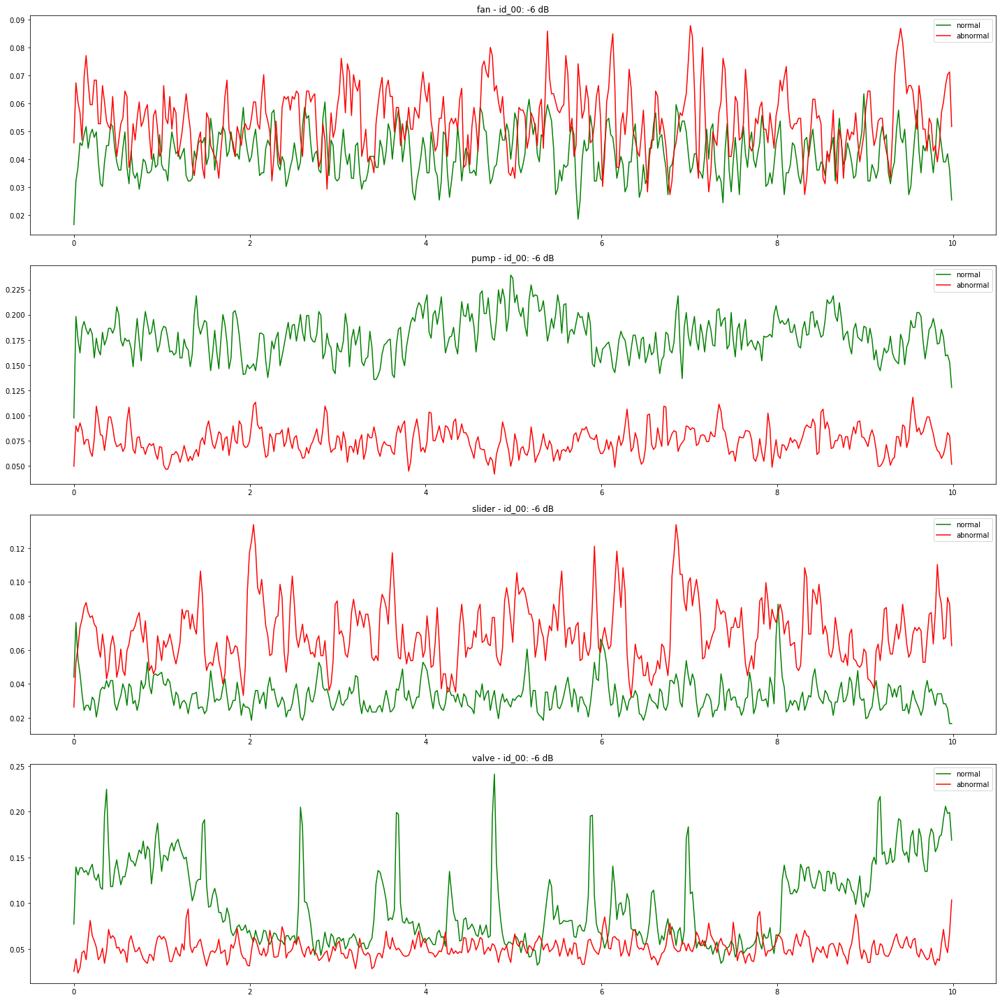

In [164]:
# Visualize the waveforms and rms in red
fig, axs = plt.subplots(len(sound_list),1, figsize=(20, 20))
counter = 0
frames = range(0, len(sound_list[0].rms_normal))
time = librosa.frames_to_time(frames, hop_length=HOP_LENGTH)

for sound in sound_list:

    axs[counter].plot(time, sound.zcr_normal, color='green', label="normal")
    axs[counter].plot(time, sound.zcr_abnormal, color='red', label="abnormal")
    axs[counter].set_title(f"{sound}")
    axs[counter].legend()
    # axs[i].set_ylim([-1, 1])
    counter += 1
    
plt.tight_layout()
plt.show()